# Taller 1

Integrantes: Juliana Bermúdez Guzmán, Sofía Duarte Sanabria.

## Librerías

In [1]:
import cv2
import numpy as np
import glob
import matplotlib.pyplot as plt
import itertools
import pycolmap


## Calibración de la cámara

Antes de empezar con las imágenes del objeto que queremos construir en 3D, calibramos la cámara utilizando fotos de un tablero de ajedrez, almacenadas en la carpeta `imagenes/chessboard`. El código de esta calibración es tomado de la tarea de clase.

In [2]:
#Ajustamos al tamaño de nuestro tablero
chessboard_size = (7, 7)  # Solo vamos a tomar las esquinas internas porque las externas colapsan
square_size = 2  # Tamaño del cuadrado en cm

# Vamos a preparar los arreglos donde van a ir los valores
objp = np.zeros((chessboard_size[0] * chessboard_size[1], 3), np.float32) #Como nuestro tablero es 7x7 y cada esquina tiene coordenadas (X,Y,Z) generamos un arreglo de 49 elementos cada uno con sus tres coordenadas
#print(objp)
objp[:, :2] = np.mgrid[0:chessboard_size[0], 0:chessboard_size[1]].T.reshape(-1, 2) #np.mgrid genera dos arreglos dos dimensionadles que tienen que ser reshaped y a los que se les asignan nuevamente las coordenadas X y Y
#print(objp)
objp *= square_size  # Dado el tamaño del cuadrado que definimos previamente, podemos multiplicar para garantizar que tengamos distancias d ela vida real
#print(objp)

# Acá vamos a guardar los putnos
obj_points = []  # 3D putnos reales
img_points = []  # 2D putnos en el plano

# Utilizamos glob para traer todas las imágenes que guardamos en una carpeta.
image_files = glob.glob("../imagenes/chessboard/*.jpg")
# print (len(image_files))
for file in image_files:
    img = cv2.imread(file) #Traemos la imagen
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) #Usamos la función que vimos en clase para convertirla a negro (en este caso el color no nos ayuda entonces es mejor reducir la dimensionalidad)

    # Detectamos los bordes utilizando la función findChessboardCorners (https://docs.opencv.org/4.x/d9/d0c/group__calib3d.html)
    ret, corners = cv2.findChessboardCorners(gray, chessboard_size, None)

    if ret: #Esto significa que las logro encontrar :)!!
        obj_points.append(objp)
        img_points.append(corners)

# TUtilizamos la función calibrateCamera
ret, k, distortion_coeffs, rvecs, tvecs = cv2.calibrateCamera(
    obj_points, img_points, gray.shape[::-1], None, None
)

# Imprimimos la matriz de la cámara y los coeficientes de distorsión
print("Matriz de la cámara:\n", k)
print("Coeficientes de distorsión:\n", distortion_coeffs)

# Guardamos los parámetros de calibración
np.savez("camera_calibration.npz",
         camera_matrix=k,
         distortion_coeffs=distortion_coeffs)

Matriz de la cámara:
 [[2.24410636e+03 0.00000000e+00 6.10150225e+02]
 [0.00000000e+00 2.24155808e+03 7.73885396e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
Coeficientes de distorsión:
 [[-6.67676495e-01  2.82241536e+01 -1.71949199e-02 -1.65012354e-03
  -2.64114498e+02]]


## Preprocesamiento de imágenes

Vamos a utilizar la librería `glob` para extraer las imágenes de la carpeta de imágenes del objeto a reconstruir: un carro LEGO. Las imágenes están almacenadas en la carpeta `imagenes/carro`. Además, organizamos las imágenes por número para realizar el emparejamiento (explicado más adelante).

In [3]:
image_files = glob.glob('../imagenes/carro/*.jpg')
# Ordenar por número en el nombre de la imagen
image_files.sort(key=lambda x: int(x.split('\\')[-1].split(".")[0]))

Utilizamos la función `imread()` para leer las imágenes ya que tenemos sus ubicaciones guardadas en la variable `image_files`. Convertimos las imágenes a escala de grises para optimizar el procesamiento.

In [4]:
# leer imágenes en blanco y negro
images_gray = [cv2.imread(img, cv2.IMREAD_GRAYSCALE) for img in image_files]

Verificamos que todas las imágenes tengan la misma dimensión. A través del bucle que definimos a continuación, comparamos las dimensiones de todas las imágenes y vemos que como no sale el mensaje de alerta, tienen la misma dimensión. Ya esperábamos que pasara esto dado que utilizamos la misma cámara, pero dado que es un paso importante del preprocesamiento cuando se tienen diversas fuentes, preferimos verificarlo.

In [5]:
for i in range(len(images_gray)):
    if i+1 == len(images_gray):
        break
    if images_gray[i].shape != images_gray[i+1].shape:
        print('Las imagenes NO tienen el mismo tamaño')
    

Decidimos utilizar la función `equalizeHist()` para mejorar el contraste redistribuyendo los níveles de intensidad de la imágen.

In [6]:
images_equalized = [cv2.equalizeHist(img) for img in images_gray]

Ahora, utilizamos la función `fastN1MeansDenoising()` [1] para eliminar el ruido sin perder tantos detalles. Elegimos este método, dado que la mayoría de filtros solo toman a los vecinos, mientras que este busca en diferentes regiones dentro de la imagen al tiempo. Otro punto a favor de este método es su capacidad de mantener texturas y bordes intactos, dado que el método gaussiano suaviza bordes y el bilateral puede llegar a hacer uqe pequeños detalles se vean borrosos. Finalmente, este método está optimizado para imágenes en escala de grises, entonces nos sirve dado que estamos trabjando en esa escala [2].

Los hiperparámetros represenan lo siguiente:
* h: potencia del filtro.
* templateWindowSize: tamaño de la región que se va a comparar.
* searchWindowSize: la ventana más grande sobre la que se van a buscar las regiones.

In [7]:
images_denoised = [cv2.fastNlMeansDenoising(img, None, h=10, templateWindowSize=7, searchWindowSize=21)
                    for img in images_equalized]

Ahora visualizamos las imágenes con el filtro aplicado.

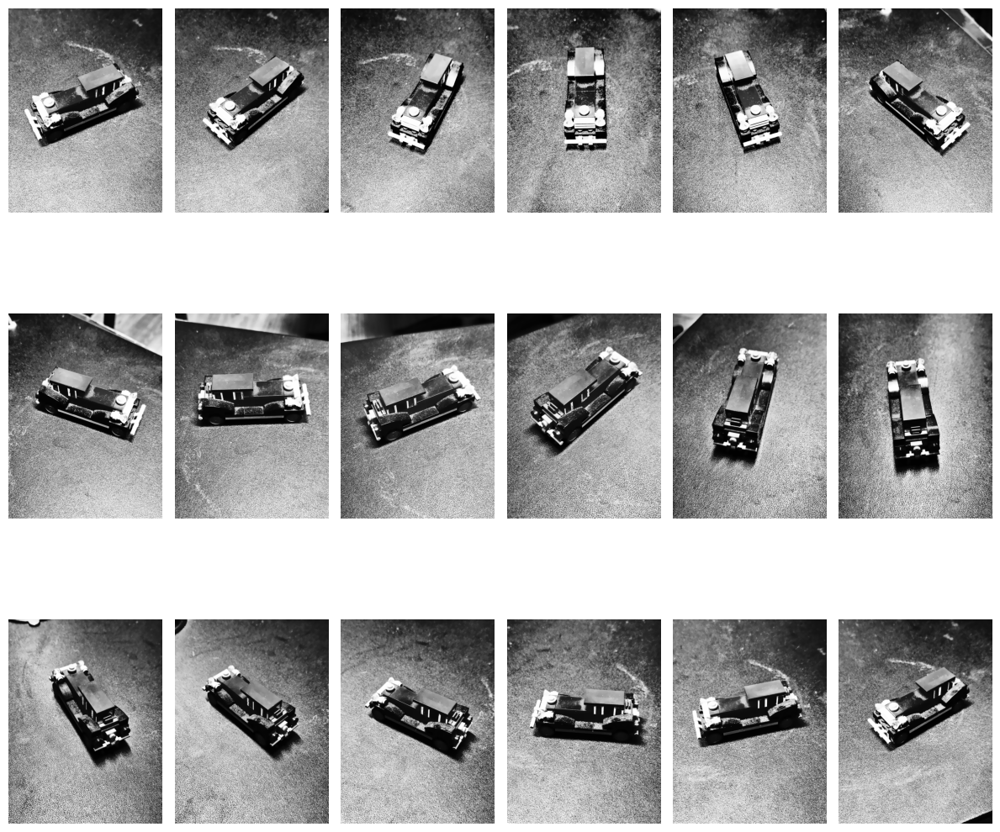

In [8]:
plt.figure(figsize=(12, 12))
rows, cols = 3, 6
for i, img in enumerate(images_denoised):
    plt.subplot(rows, cols, i + 1)
    plt.imshow(img, cmap='gray')
    plt.axis('off')
plt.tight_layout()
plt.show()

Al analizar las imágenes podemos ver que los bordes del objeto a reconstruir se mantienen con buen contraste. Esto facilitará la tarea de la detección de características.

Guardaremos las imágenes con filtro de manera local para utilizarlas más adelante.

In [9]:
for i in range(1, len(images_denoised)+1):
    cv2.imwrite(f'../imagenes/carroFiltro/{i}.jpg', images_denoised[i-1])

## Detección de Características y Emparejamiento

Vamos a aplicar ORB, entonces tenemos que inicializar el detector. 

In [10]:
orb = cv2.ORB_create()

Ahora, lo aplicamos sobre las imágenes a las que les quitamos el ruido.

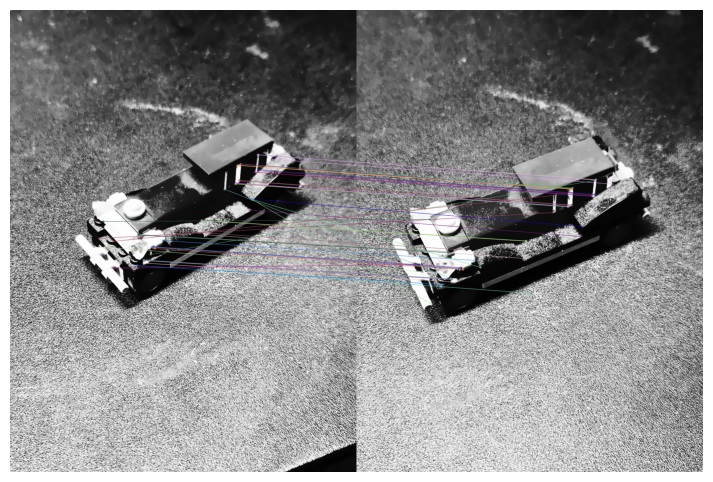

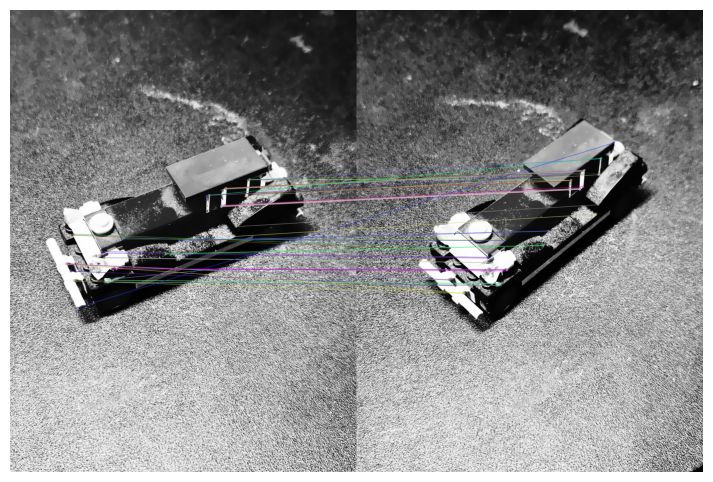

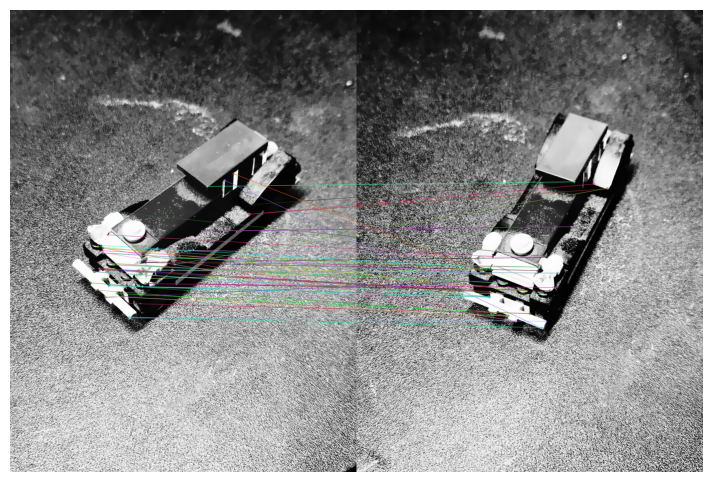

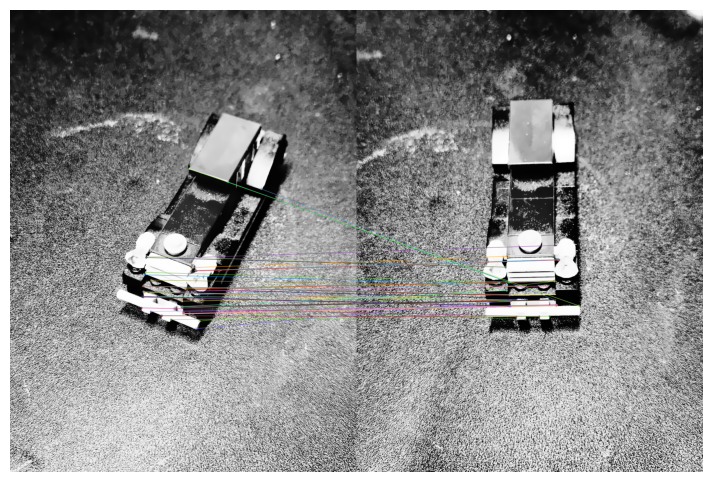

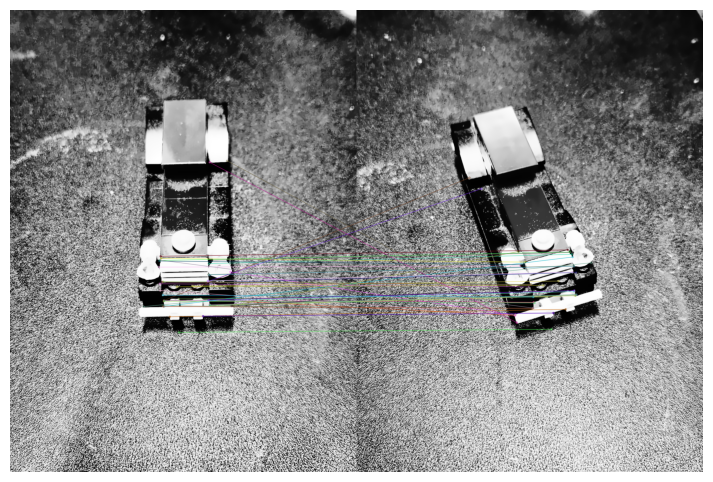

...

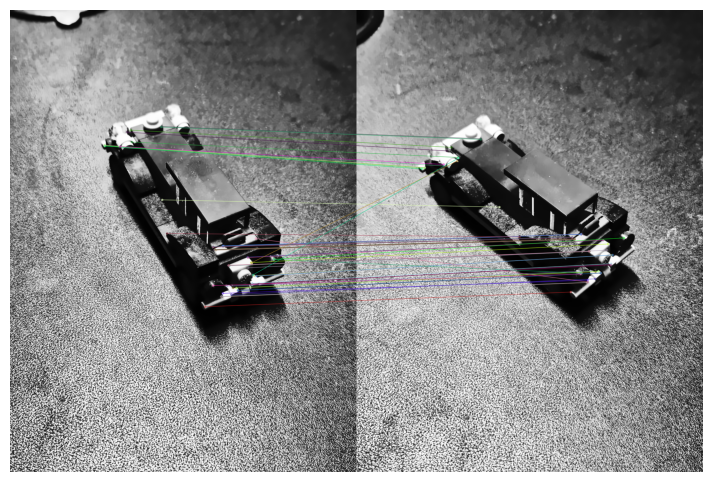

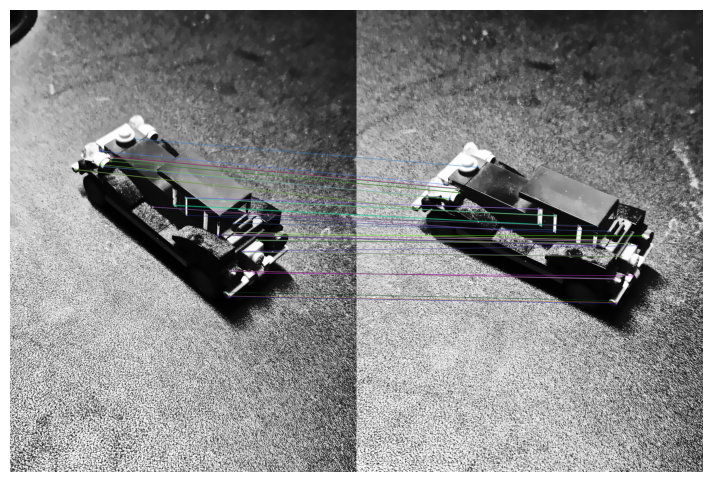

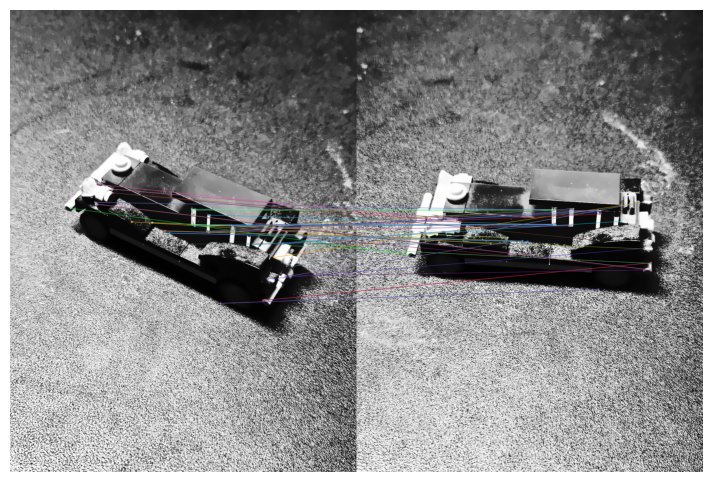

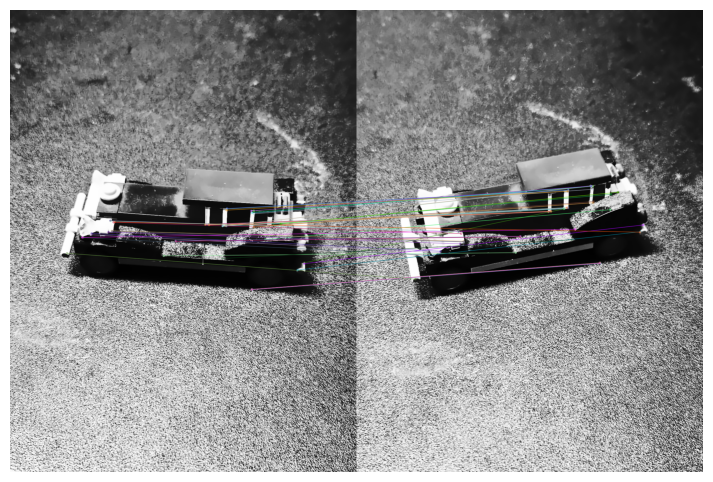

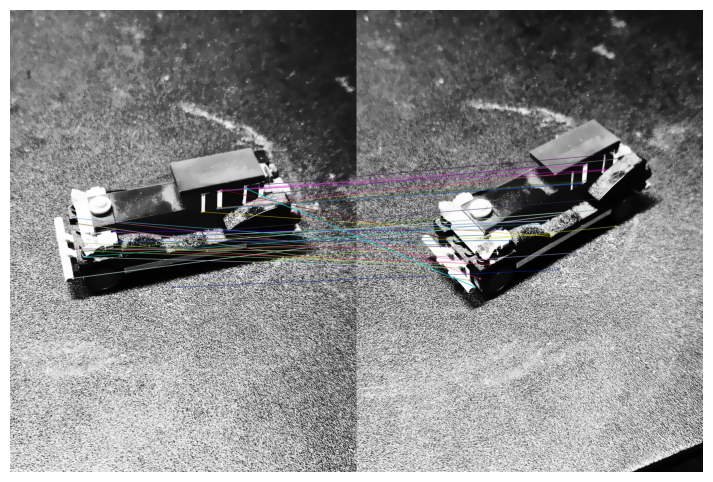

In [11]:
# Utilizamos un Brute Force Matcher para realizar el emparejamiento
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# Guardamos la información del emparejamiento para más adelante
keypoints = []
descriptors = []
matchess = []

for i in range(-1, len(images_denoised)-1):
    keypoints1, descriptors1 = orb.detectAndCompute(images_denoised[i], None)
    keypoints2, descriptors2 = orb.detectAndCompute(images_denoised[i+1], None)
    matches = bf.match(descriptors1, descriptors2)
    matches = sorted(matches, key=lambda x: x.distance)
    keypoints.append((keypoints1, keypoints2))
    descriptors.append((descriptors1, descriptors2))
    matchess.append(matches)

    # Gráficas
    img_matches = cv2.drawMatches(images_denoised[i], keypoints1, images_denoised[i+1], keypoints2, matches[:50], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.figure(figsize=(12, 6))
    plt.imshow(img_matches)
    plt.axis('off')
    plt.show()

Vemos que el resultado del emparejamiento es satisfactorio. Aunque hay algunos errores (las líneas que se ven cruzadas con respecto a las demás), la cantidad es mínima con respecto al total de puntos emparejados.

## Estimación de la Matriz Fundamental y la Matriz Esencial

### Matriz Fundamental

A continuación, utilizamos RANSAC para estimar las matrices fundamentales entre cada par de imágenes emparejadas. Además, con ayuda de la matriz fundamental asociada, podemos filtrar el emparejamiento y eliminar outliers.

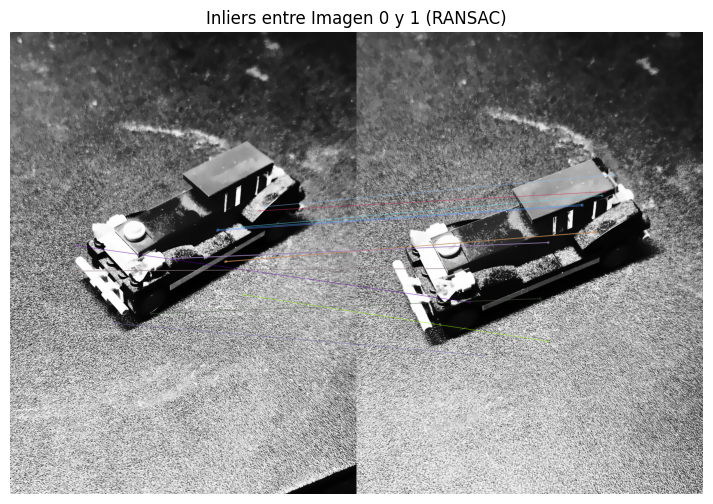

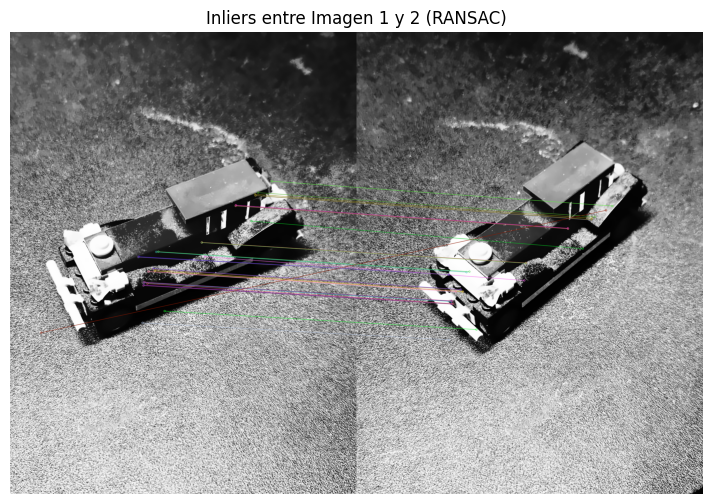

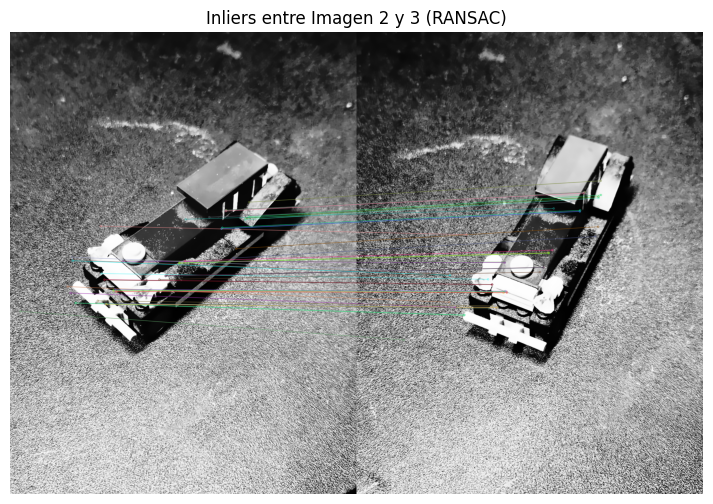

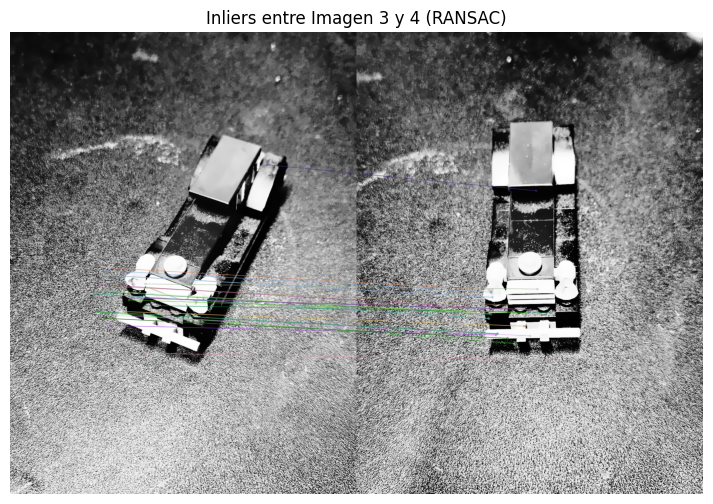

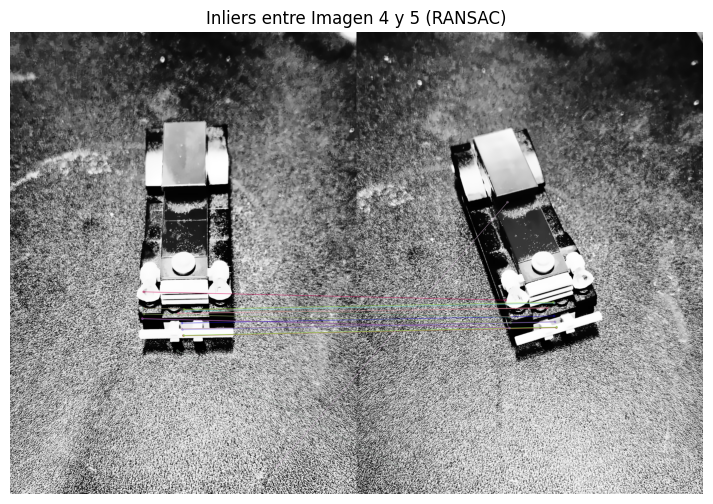

...

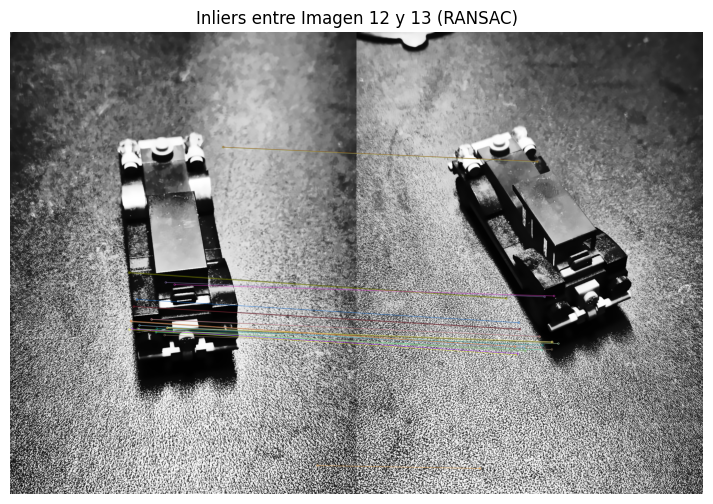

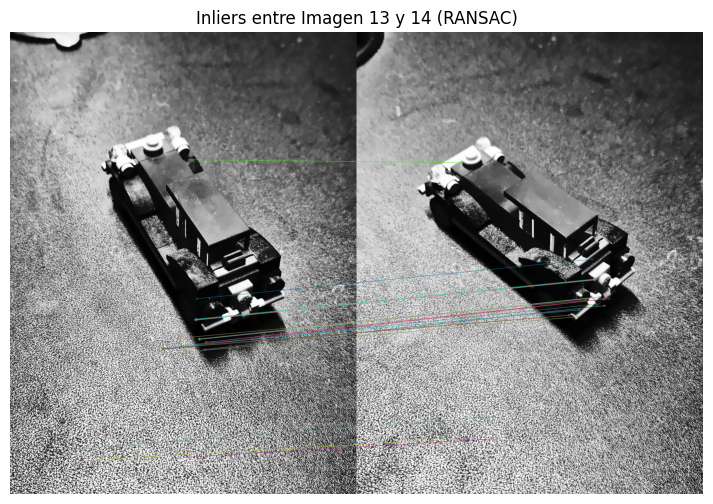

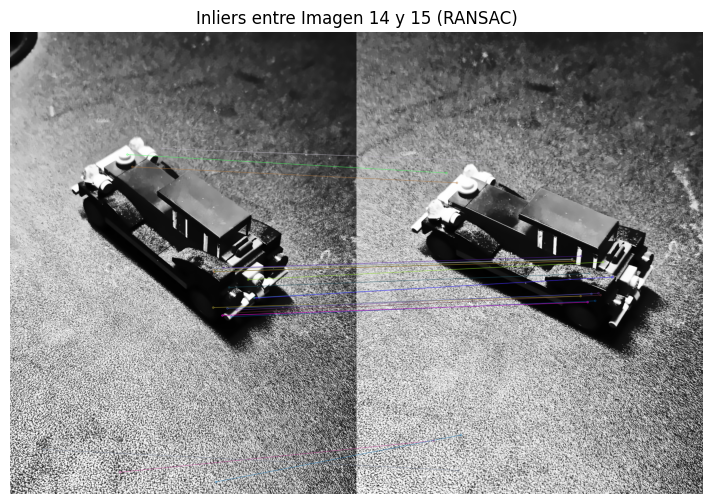

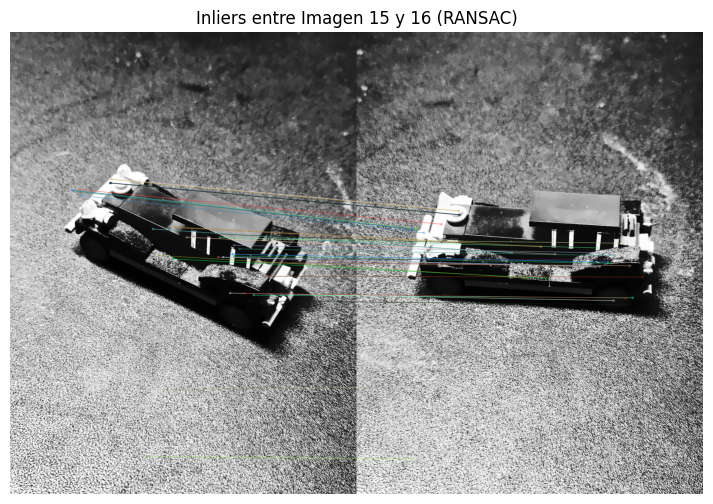

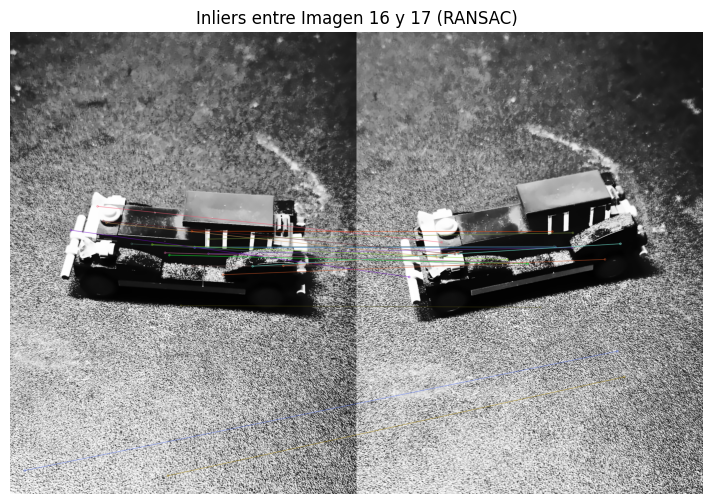

Matriz Fundamental entre Imagen 1 e Imagen 2:
 [[-5.40270166e-07  3.14991967e-06 -3.24672681e-03]
 [-1.75483023e-06  2.96767857e-07  3.39900725e-04]
 [ 2.50968181e-03 -1.78068858e-03  1.00000000e+00]]
Matriz Fundamental entre Imagen 2 e Imagen 3:
 [[ 2.14550448e-09 -5.75376010e-06  2.11256904e-03]
 [ 7.46390070e-06 -4.25447152e-07 -8.36055905e-03]
 [-3.23865388e-03  7.33314384e-03  1.00000000e+00]]
Matriz Fundamental entre Imagen 3 e Imagen 4:
 [[ 2.45097247e-06 -1.55251494e-05  3.91549899e-03]
 [ 8.30160554e-06 -1.22120379e-06 -4.29040514e-02]
 [-1.03481334e-02  4.95156120e-02  1.00000000e+00]]
Matriz Fundamental entre Imagen 4 e Imagen 5:
 [[ 2.42397238e-06 -6.81061842e-06  5.27218972e-03]
 [ 5.46613149e-06  2.47764908e-06 -2.67851675e-03]
 [-6.00270338e-03 -3.43834026e-04  1.00000000e+00]]
Matriz Fundamental entre Imagen 5 e Imagen 6:
 [[ 1.75968798e-06 -4.33221251e-06  3.29162264e-03]
 [ 4.52133889e-06  4.74458907e-07 -3.73388114e-03]
 [-5.83705883e-03  3.02436861e-03  1.00000000e+

In [12]:
fundamental_matrices = [] # Guardamos las matrices fundamentales
pts = [] # Guardamos las coordenadas de los puntos emparejados

for i in range(-1, len(matchess)-2):
    keypoints1, keypoints2 = keypoints[i]
    matches = matchess[i]

    # Extraer coordenadas de los puntos emparejados
    pts1 = np.float32([keypoints1[m.queryIdx].pt for m in matches])
    pts2 = np.float32([keypoints2[m.trainIdx].pt for m in matches])
    
    pts.append((pts1, pts2))

    # Calcular la matriz fundamental con RANSAC
    F, mask = cv2.findFundamentalMat(pts1, pts2, cv2.FM_RANSAC, ransacReprojThreshold=1.0, confidence=0.99)
    fundamental_matrices.append(F)

    # Filtramos para que solo nos queden los inliers
    inlier_matches = [matches[i] for i in range(len(matches)) if mask[i]]

    # Dibujamos solo los inliers
    img_inliers = cv2.drawMatches(images_denoised[i], keypoints1, images_denoised[i+1], keypoints2, inlier_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    # Mostramos la imagen con inliers
    plt.figure(figsize=(12, 6))
    plt.imshow(img_inliers)
    plt.title(f"Inliers entre Imagen {i+1} y {i+2} (RANSAC)")
    plt.axis("off")
    plt.show()

# Mostramos las matrices fundamentales obtenidas
for idx, F in enumerate(fundamental_matrices):
    print(f"Matriz Fundamental entre Imagen {idx+1} e Imagen {idx+2}:\n", F)

Vemos que la cantidad de emparejamientos erróneos disminuye significativamente después de filtrar.

### Matriz Esencial

Ahora calculamos las matrices esenciales entre cada par de imágenes por medio de la operación

$$E = K^TFK$$

donde $K$ es la matriz de la cámara (obtenida en la sección de calibración), y $F$ es la matriz fundamental asociada al par de imágenes.

In [13]:
essential_matrices = [] # Guardamos las matrices esenciales
for F in fundamental_matrices:
    E = k.T @ F @ k  # Cálculo de la matriz esencial
    essential_matrices.append(E)

# Mostramos las matrices esenciales obtenidas
for idx, E in enumerate(essential_matrices):
    print(f"Essential Matrix between Image {idx+1} and {idx+2}:\n", E)

Essential Matrix between Image 1 and 2:
 [[-2.72080776 15.84502435 -2.55535479]
 [-8.82731327  1.49113462 -1.12334568]
 [ 1.84465173  0.83139374  0.07062964]]
Essential Matrix between Image 2 and 3:
 [[ 1.08047892e-02 -2.89431091e+01 -5.24867930e+00]
 [ 3.75456204e+01 -2.13769437e+00 -9.27042451e+00]
 [ 5.69746951e+00  7.83029694e+00  7.13215323e-02]]
Essential Matrix between Image 3 and 4:
 [[ 12.34313003 -78.09607744 -14.81946355]
 [ 41.75952266  -6.13603934 -86.9363571 ]
 [ -5.4490957   87.64013921  -1.03806312]]
Essential Matrix between Image 4 and 5:
 [[ 1.22071572e+01 -3.42594180e+01  3.32248669e+00]
 [ 2.74962525e+01  1.24491525e+01  5.76990736e+00]
 [-6.58772572e-01 -5.78751904e+00 -3.32595664e-02]]
Essential Matrix between Image 5 and 6:
 [[  8.86181212 -21.79230577   2.27251823]
 [ 22.7436672    2.38395798  -1.3628861 ]
 [ -2.83741818   1.67723461  -0.07362173]]
Essential Matrix between Image 6 and 7:
 [[  0.44422358   2.77473895  -9.95062675]
 [  0.5828591   -9.63169329 -28.

### Rotación y traslación

A partir de la matriz esencial podemos determinar la rotación y traslación de la cámara entre cada par de imágenes. 

In [14]:
R_matrices = [] # Guardamos las matrices de rotación
t_vectors = [] # Guardamos los vectores de traslación
pts_copy = pts.copy() # Creamos una copia para no perder los puntos originales
for E in essential_matrices:
    pts1, pts2 = pts_copy.pop(0)
    _, R, t, _ = cv2.recoverPose(E, pts1, pts2, k)
    R_matrices.append(R)
    t_vectors.append(t)

for i, (R, t) in enumerate(zip(R_matrices, t_vectors)):
    print(f"Rotation Matrix for Image {i+1} -> {i+2}:\n", R)
    print(f"Translation Vector for Image {i+1} -> {i+2}:\n", t)

Rotation Matrix for Image 1 -> 2:
 [[ 0.99817986  0.05637481  0.02142065]
 [-0.05791705  0.99511657  0.07992891]
 [-0.01681007 -0.08102405  0.99657038]]
Translation Vector for Image 1 -> 2:
 [[ 0.07218219]
 [-0.22528765]
 [-0.97161474]]
Rotation Matrix for Image 2 -> 3:
 [[ 0.99845015 -0.04234786  0.03611034]
 [ 0.04163305  0.99892626  0.02032276]
 [-0.03693219 -0.01878788  0.99914115]]
Translation Vector for Image 2 -> 3:
 [[-0.2683455 ]
 [ 0.14460312]
 [-0.95240781]]
Rotation Matrix for Image 3 -> 4:
 [[ 0.94606687  0.16845898 -0.27672919]
 [-0.19030044  0.98024716 -0.05386315]
 [ 0.26218927  0.10361983  0.95943719]]
Translation Vector for Image 3 -> 4:
 [[ 0.7444501 ]
 [-0.13470992]
 [ 0.65394747]]
Rotation Matrix for Image 4 -> 5:
 [[ 0.92621227  0.37284681  0.05582199]
 [-0.37271903  0.92785215 -0.01307322]
 [-0.05666886 -0.00869734  0.99835515]]
Translation Vector for Image 4 -> 5:
 [[-0.13618942]
 [ 0.08411196]
 [ 0.98710568]]
Rotation Matrix for Image 5 -> 6:
 [[ 0.96926626  0.

## Reconstrucción 3D con PyCOLMAP y COLMAP

Realizamos dos procesos para la reconstrucción 3D. En primer lugar, utilizamos un archivo de ejemplo encontrado en el repositorio de PyCOLMAP ([click aquí para acceder a la fuente](https://github.com/colmap/colmap/blob/main/pycolmap/examples/example.py)). El código de esta reconstrucción se encuentra en el archivo `pycolmapExample.py`, el cual toma como input las imágenes filtradas de la carpeta `imagenes/carroFiltro` y retorna la reconstrucción 3D en forma de archivos con extensión bin.

Esta información se almacena en la carpeta `src/example`. Ahora mostramos la reconstrucción 3D obtenida al ejecutar el archivo `visualizationSparse.py`. Este archivo toma la nube de puntos generada en el paso anterior y utiliza la función `pycolmap.Reconstruction()` para obtener los puntos 3D y graficarlos. Inicialmente, la gráfica resulta difícil de interpretar, dado que la reconstrucción se encuentra rotada. Por esto, a continuación mostramos una captura de pantalla desde el ángulo adecuado. En caso de querer visualizar la gráfica 3D por aparte, ejecute el código del archivo `visualizationSparse.py` con la primera ruta que se encuentra en el archivo.

> Nota: 
>
> Todas las imágenes de capturas de pantalla de la reconstrucción se encuentran en la carpeta `imagenes/reconstrucciones`, en caso de fallos en el renderizado de las imágenes en este notebook.

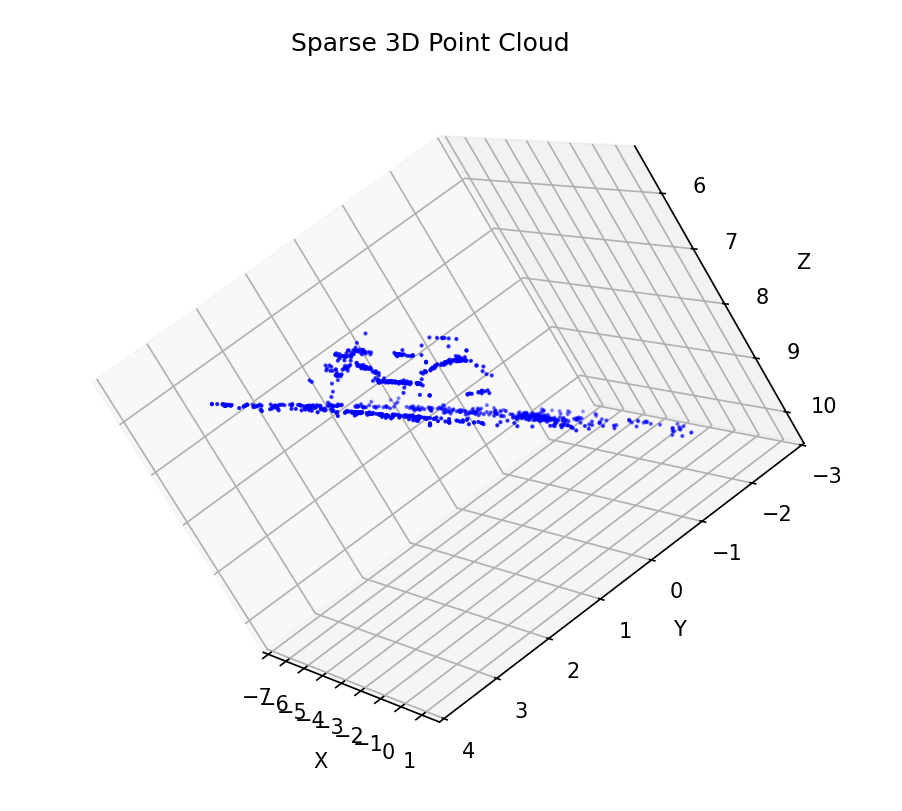

Para obtener una mejor reconstrucción del objeto, nuestra segunda opción fue instalar el software de COLMAP localmente en nuestro dispositivo y utilizar la GUI para realizar el proceso de reconstrucción 3D. Utilizamos las mismas imágenes que antes (las del filtro, almacenadas en `imagenes/carroFiltro`). Los resultados de esta reconstrucción se encuentran en la carpeta ```colmapReconstruction```.

COLMAP generó dos reconstrucciones: ```sparse``` y ```dense```. La primera reconstrucción es muy cercana a la realizada anteriormente con el archivo de ejemplo. A continuación, visualizamos esta reconstrucción, obtenida ejecutando el archivo `visualizationSparse.py`, al igual que antes, pero cambiando la ruta de origen de la reconstrucción. El problema de visualización de la gráfica sigue siendo el mismo (la rotación impide ver claramente el objeto reconstruido). Por esto, mostramos una captura de pantalla desde el ángulo correcto.

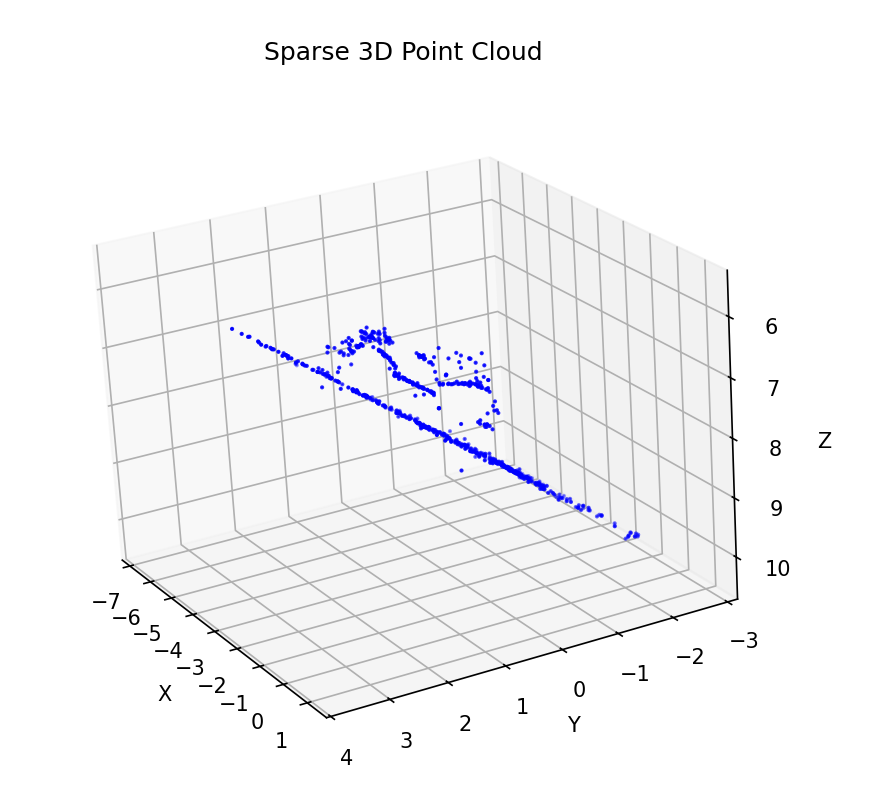

Ahora visualizamos la reconstrucción ```dense```, obtenida al ejecutar el archivo `visualizationDense.py`, esta vez renderizando utilizando open3D. La reconstrucción sigue estando rotada. Sin embargo, dada la densidad de la reconstrucción, es más fácil identificar el objeto. De igual manera, mostramos una captura de pantalla desde el mejor ángulo para visualizar la reconstrucción.

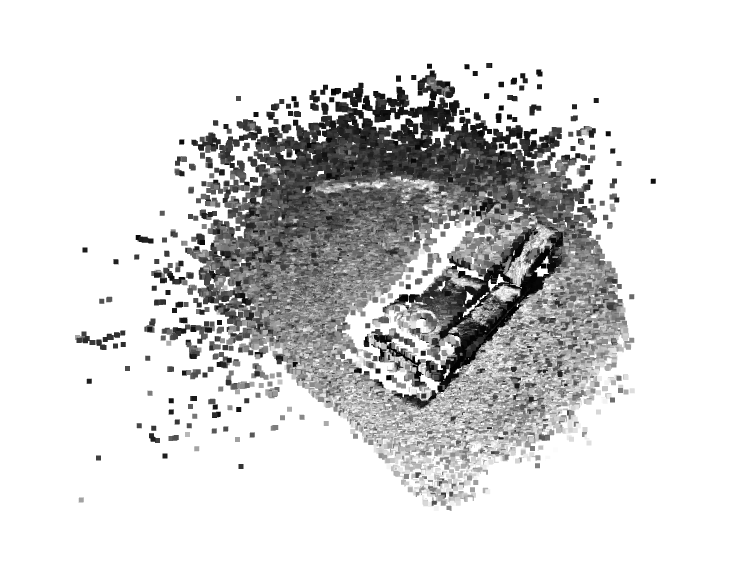

Es evidente el aumento en la calidad de la reconstrucción con respecto a la versión anterior.

## Conclusiones

- Al momento de tomar las imágenes, se aplicaron los conceptos vistos en clase como distancia focal, formación fotométrica, propiedades del color, etc. Gracias al reconocimiento de estos aspectos como factores importantes, tomamos fotos con la misma cámara, desde la misma distancia y sobre  una superficie no reflectiva. 
- Al momento de limpiar las imágenes, elegimos funciones cuyos hiperparámetros se podían configurar para difuminar el fondo y mantener la “firmeza” de las líneas que conforman el contorno de la imagen. De igual manera, elegimos una función que permite realizar suficiente contraste en las imágenes para hacer resaltar el objeto. Sin embargo, los parámetros elegidos fueron el resultado de una serie de pruebas informales hasta obtener un “buen” resultado, por lo que si se tuviera mayor costo computacional tal vez se podrían hacer aún más pruebas para elegir los hiperpar´´metros óptimos entre una mayor cantidad de opciones. 
- Al momento de encontrar la nube de puntos de coincidencias para la reconstrucción 3D intentamos dos caminos, uno que era subir las imágenes filtradas a la GUI de COLMAP en local y otro que era ejecutar un script de PyCOLMAP inspirado en la documentación. El fin de hacer estas dos pruebas era buscar maneras alternas de conseguir los mismos puntos y elegir el que se acercara más a la forma del carro, pero al fin nos dimos cuenta que ambos generan nubes de puntos demasiado similares. Por tanto, aprovechamos el GUI de COLMAP para hacer la reconstrucción 3D que ellos llaman “dense”, la cual nos dio una imagen bastante similar a las fotos que tomamos. Sin embargo, dado que este es un objeto con demasiados detalles pequeños de colores parecidos, es coherente que al momento de hacerla reconstrucción no se haya llegado exactamente a la imagen. 
- Dada la limitada capacidad computacional decidimos trabajar con imágenes a blanco y negro, pero creemos que sería bastante interesante trabajar con imágenes a color. De hecho, la mayoría de funciones que utilizamos para filtrar y procesar las imágenes a blanco y negro tienen una función “hermana” que funcionaba para imágenes a color, entonces podríamos casi que hacer el mismo proceso de limpieza.

# Referencias

[1] “Denoising,” OpenCV, https://docs.opencv.org/3.4/d1/d79/group__photo__denoise.html#ga76abf348c234cecd0faf3c42ef3dc715 (accessed Feb. 19, 2025). 

[2] GeeksforGeeks, “Image enhancement techniques using opencv - python,” GeeksforGeeks, https://www.geeksforgeeks.org/image-enhancement-techniques-using-opencv-python/ (accessed Feb. 19, 2025). 